In [113]:
import numpy as np
import scanpy as sc
import matplotlib.pyplot as plt
from numpy.random import default_rng
import squidpy as sq
import pandas as pd
import anndata as ad
from pathlib import Path
from jax.config import config
import seaborn as sns
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from joblib import delayed, Parallel
from anndata import AnnData
import mplscience
import squidpy as sq
from tqdm import tqdm
import itertools
from scipy import stats
import matplotlib as mpl

mplscience.set_style()
plt.rcParams["legend.scatterpoints"] = 1
config.update("jax_enable_x64", True)
# # sc.set_figure_params()
%load_ext autoreload
%autoreload 2
%load_ext lab_black

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
The lab_black extension is already loaded. To reload it, use:
  %reload_ext lab_black


In [2]:
# function that compute a 2D rotation matrix given angle in degree
def rotation_matrix(angle: float) -> np.ndarray:
    angle = np.deg2rad(angle)
    return np.array([[np.cos(angle), -np.sin(angle)], [np.sin(angle), np.cos(angle)]])


adata = sc.read(
    "/lustre/groups/ml01/workspace/moscot_paper/benchmarks/space/sink_brain/adata_aligned_section1.h5ad"
)
rot = rotation_matrix(13)
adata.obsm["spatial_rot"] = adata.obsm["spatial_norm_final"] @ rot
# sc.pp.calculate_qc_metrics(adata, percent_top=None, inplace=True)

In [38]:
inset_ymin = -0.1
inset_xmin = 0.6
inset_ymax = 0.2
inset_xmax = 0.9

/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


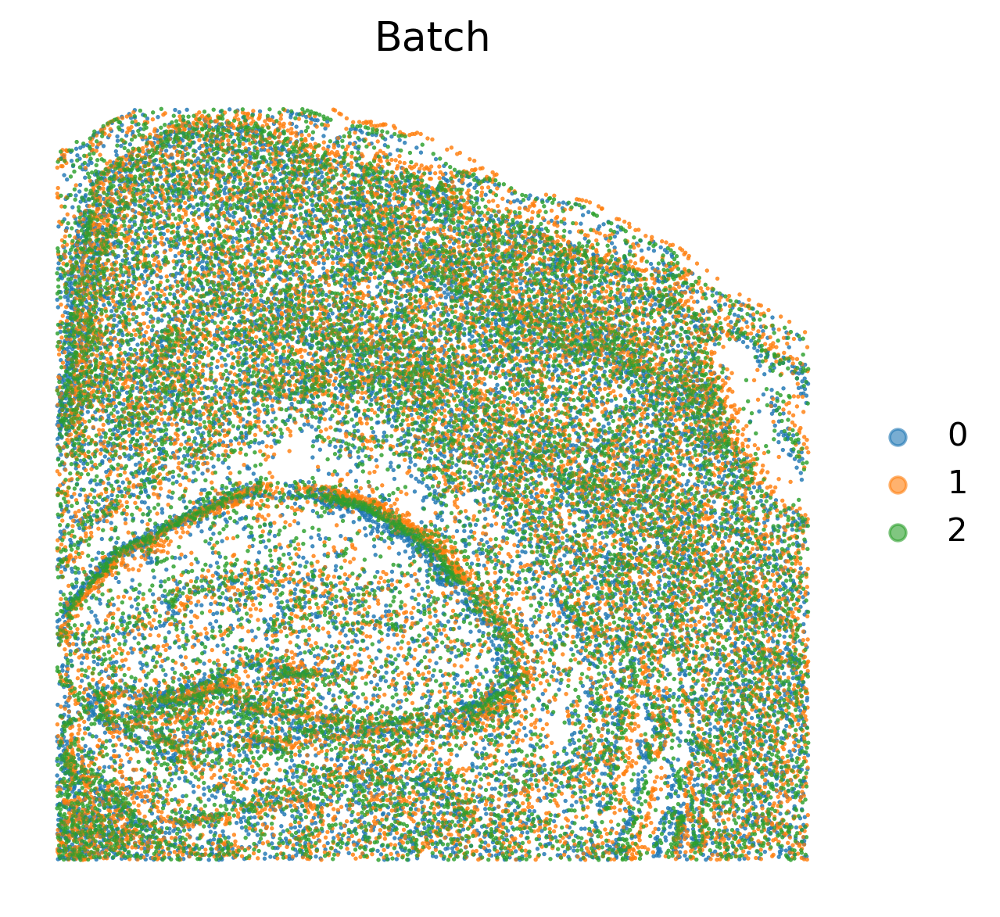

In [99]:
sq.pl.spatial_scatter(
    adata,
    spatial_key="spatial_rot",
    shape=None,
    color=["batch_final"],
    size=1,
    figsize=(5, 5),
    # legend_loc=None,
    edgecolors=None,
    frameon=False,
    alpha=0.6,
    dpi=250,
    crop_coord=(inset_xmin, inset_ymin, inset_xmax, inset_ymax),
    title="Batch",
)

In [90]:
# sorted(adata.var_names.tolist())

/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:411: ImplicitModificationWarning: Trying to modify attribute `.obsm` of view, initializing view as actual.
  coords[:, 0] -= crop_coords.x0
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:412: ImplicitModificationWarning: Trying to modify attribute `.obsm` of view, initializing view as actual.
  coords[:, 1] -= crop_coords.y0


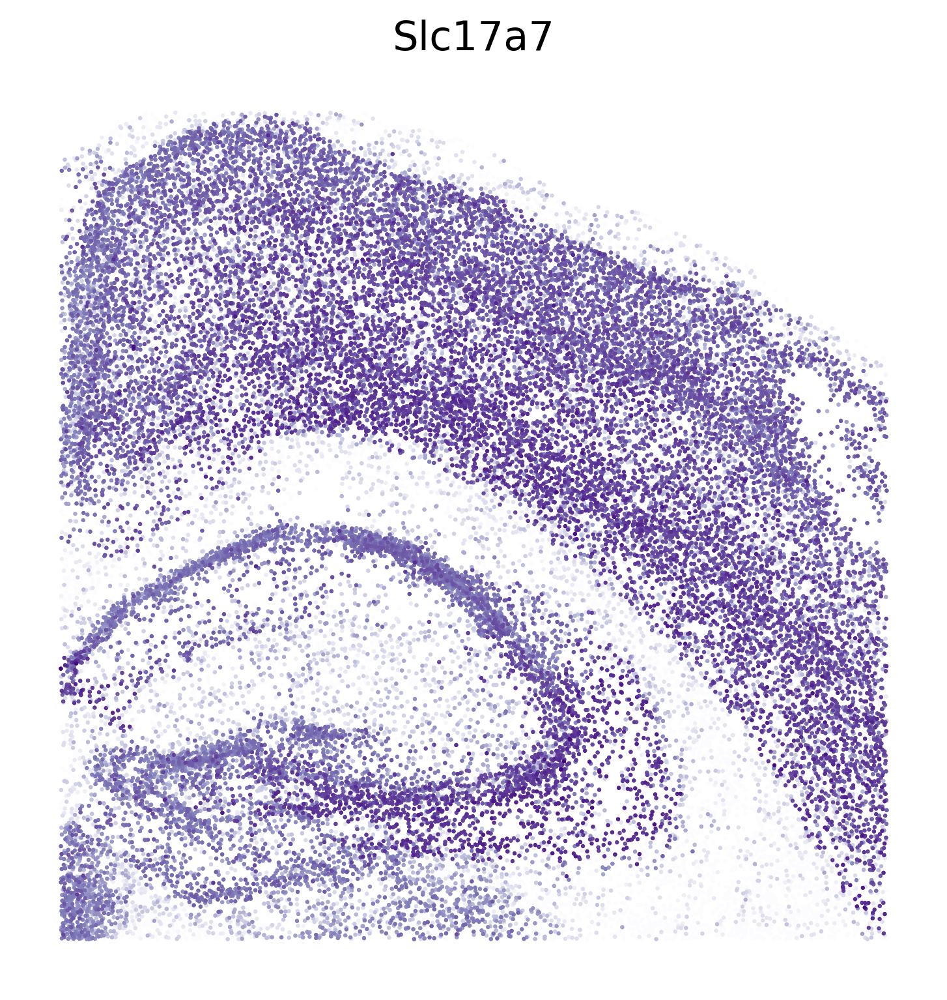

In [100]:
gene = "Slc17a7"
spatial = adata.obsm["spatial_rot"]
cond = (
    (spatial[:, 0] > inset_xmin)
    & (spatial[:, 0] < inset_xmax)
    & (spatial[:, 1] > inset_ymin)
    & (spatial[:, 1] < inset_ymax)
)
adata_temp = adata[cond]
sq.pl.spatial_scatter(
    adata_temp[adata_temp[:, gene].X.A.flatten().argsort()],
    spatial_key="spatial_rot",
    shape=None,
    color=[gene],
    frameon=False,
    cmap="Purples",
    size=1,
    figsize=(5, 5),
    dpi=300,
    colorbar=False,
    crop_coord=(inset_xmin, inset_ymin, inset_xmax, inset_ymax),
    title=f"{gene}",
)

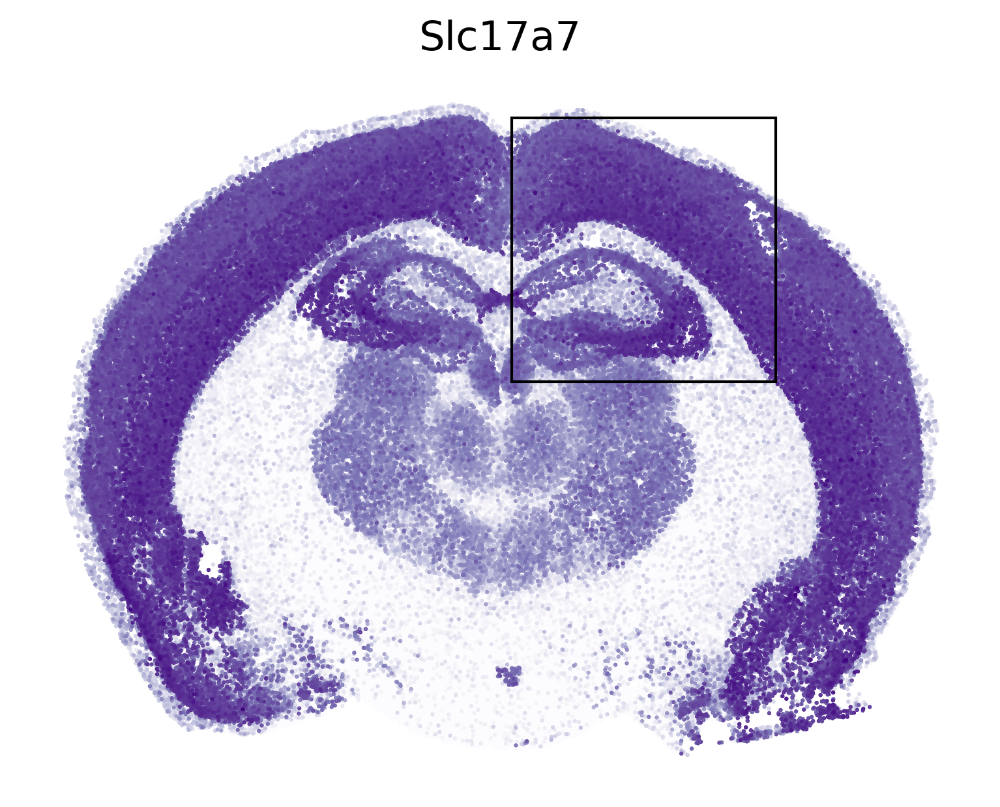

In [124]:
gene = "Slc17a7"
spatial = adata.obsm["spatial_norm_final"]
adata_temp = adata
ax = sq.pl.spatial_scatter(
    adata_temp[adata_temp[:, gene].X.A.flatten().argsort()],
    spatial_key="spatial_rot",
    shape=None,
    color=[gene],
    frameon=False,
    cmap="Purples",
    size=1,
    figsize=(5, 5),
    dpi=300,
    colorbar=False,
    return_ax=True,
    title=f"{gene}",
)
rect = mpl.patches.Rectangle(
    (inset_xmin, inset_ymin),
    width=inset_ymax - inset_ymin,
    height=inset_xmax - inset_xmin,
    ec="black",
    lw=1,
    fill=False,
)
ax.add_patch(rect)

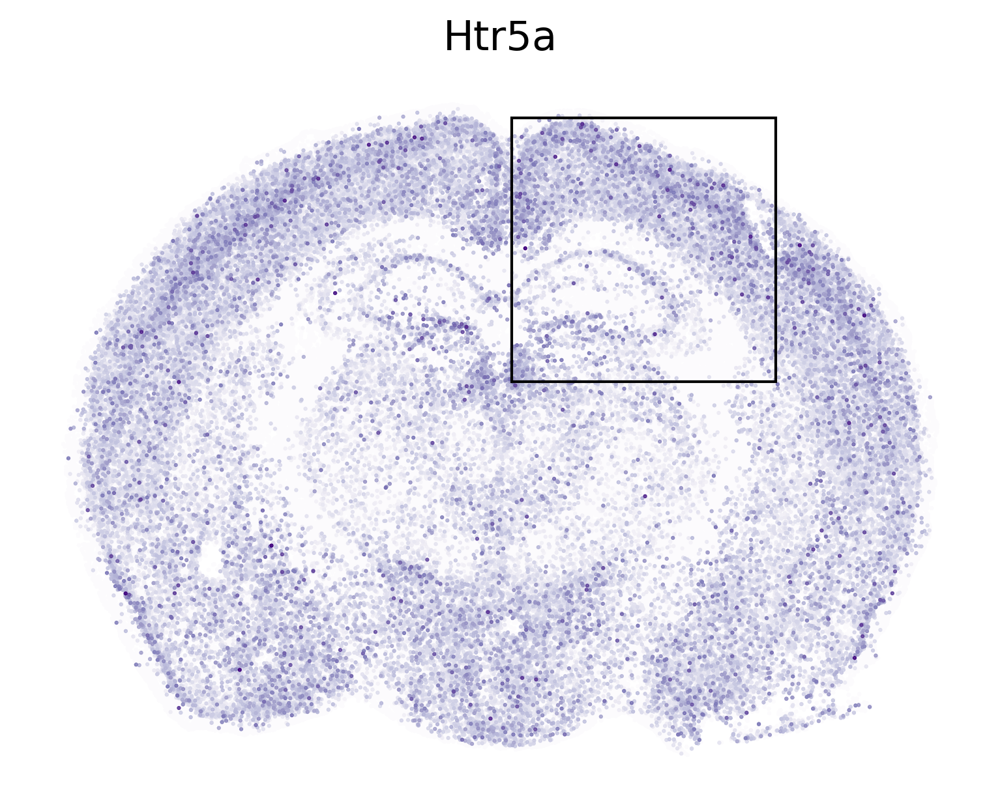

In [126]:
gene = "Htr5a"
spatial = adata.obsm["spatial_norm_final"]
adata_temp = adata
ax = sq.pl.spatial_scatter(
    adata_temp[adata_temp[:, gene].X.A.flatten().argsort()],
    spatial_key="spatial_rot",
    shape=None,
    color=[gene],
    frameon=False,
    cmap="Purples",
    size=1,
    figsize=(5, 5),
    dpi=300,
    colorbar=False,
    return_ax=True,
    title=f"{gene}",
)
rect = mpl.patches.Rectangle(
    (inset_xmin, inset_ymin),
    width=inset_ymax - inset_ymin,
    height=inset_xmax - inset_xmin,
    ec="black",
    lw=1,
    fill=False,
)
ax.add_patch(rect)

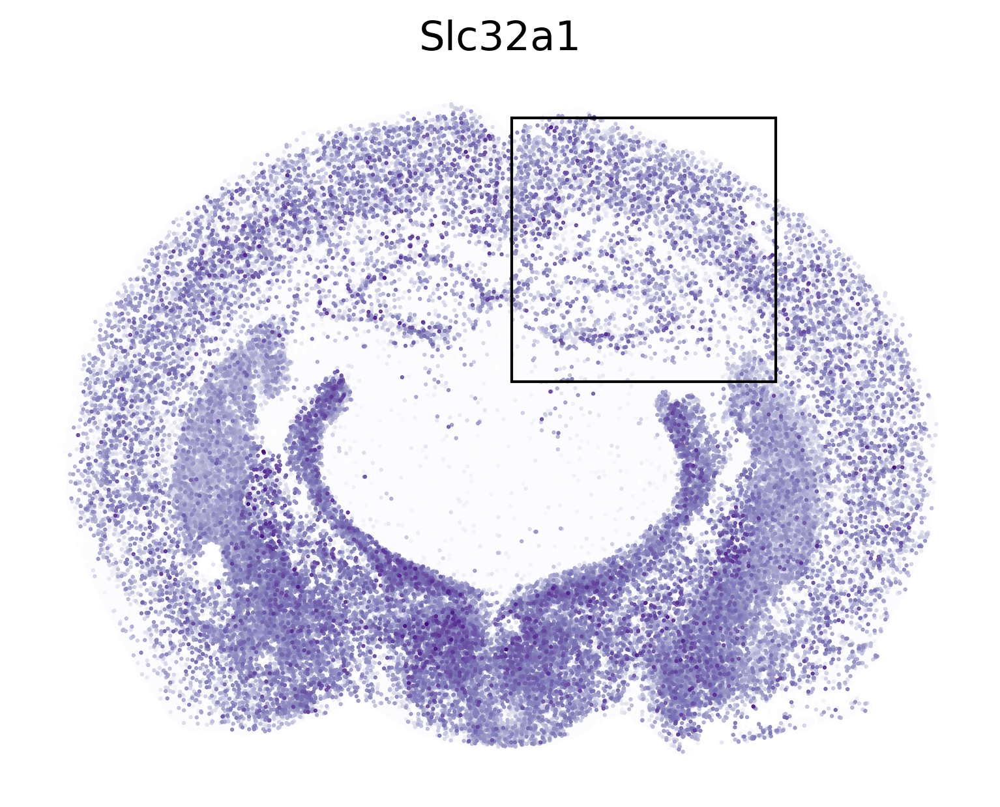

In [128]:
gene = "Slc32a1"
spatial = adata.obsm["spatial_norm_final"]
adata_temp = adata
ax = sq.pl.spatial_scatter(
    adata_temp[adata_temp[:, gene].X.A.flatten().argsort()],
    spatial_key="spatial_rot",
    shape=None,
    color=[gene],
    frameon=False,
    cmap="Purples",
    size=1,
    figsize=(5, 5),
    dpi=300,
    colorbar=False,
    return_ax=True,
    title=f"{gene}",
)
rect = mpl.patches.Rectangle(
    (inset_xmin, inset_ymin),
    width=inset_ymax - inset_ymin,
    height=inset_xmax - inset_xmin,
    ec="black",
    lw=1,
    fill=False,
)
ax.add_patch(rect)

/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


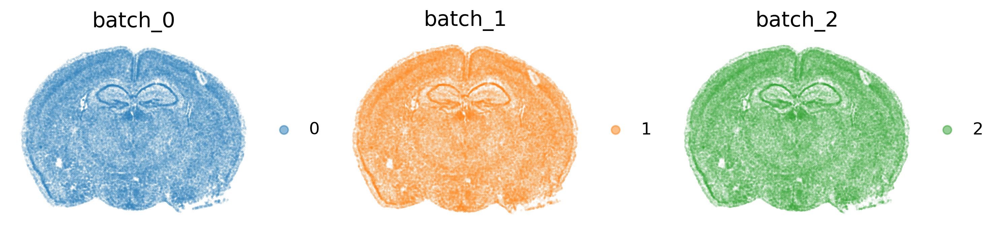

In [106]:
fig, ax = plt.subplots(1, 3, figsize=(10, 3), dpi=300)
for i, a in enumerate(ax):
    sq.pl.spatial_scatter(
        adata,
        spatial_key="spatial_rot",
        shape=None,
        color="batch_final",
        groups=[f"{i}"],
        frameon=False,
        title=[f"batch_{i}"],
        size=0.01,
        alpha=0.5,
        fig=fig,
        ax=a,
    )
plt.tight_layout()

/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


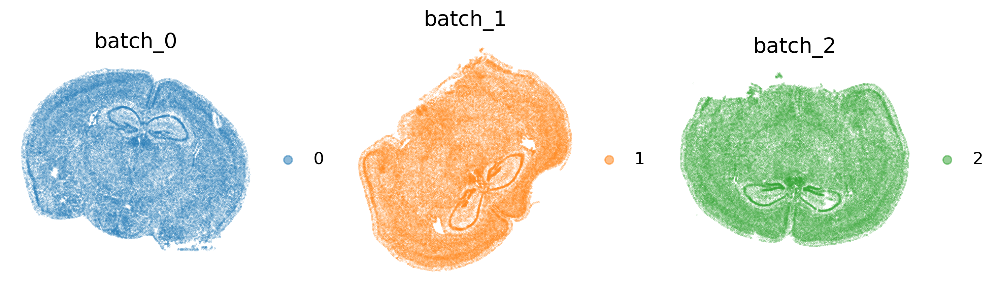

In [107]:
fig, ax = plt.subplots(1, 3, figsize=(10, 3), dpi=300)
for i, a in enumerate(ax):
    sq.pl.spatial_scatter(
        adata,
        spatial_key="spatial_norm",
        shape=None,
        color="batch_final",
        groups=[f"{i}"],
        frameon=False,
        title=[f"batch_{i}"],
        size=0.01,
        alpha=0.5,
        fig=fig,
        ax=a,
    )
plt.tight_layout()

In [109]:
rot = rotation_matrix(13)
adata.obsm["spatial_norm_affine_rot"] = adata.obsm["spatial_norm_affine"] @ rot

/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


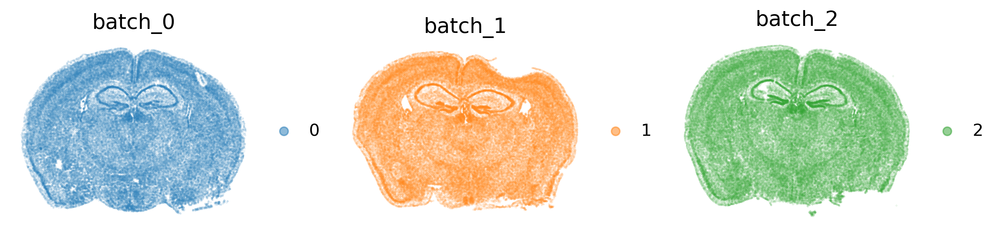

In [110]:
fig, ax = plt.subplots(1, 3, figsize=(10, 3), dpi=300)
for i, a in enumerate(ax):
    sq.pl.spatial_scatter(
        adata,
        spatial_key="spatial_norm_affine_rot",
        shape=None,
        color="batch_final",
        groups=[f"{i}"],
        frameon=False,
        title=[f"batch_{i}"],
        size=0.01,
        alpha=0.5,
        fig=fig,
        ax=a,
    )
plt.tight_layout()

/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:956: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


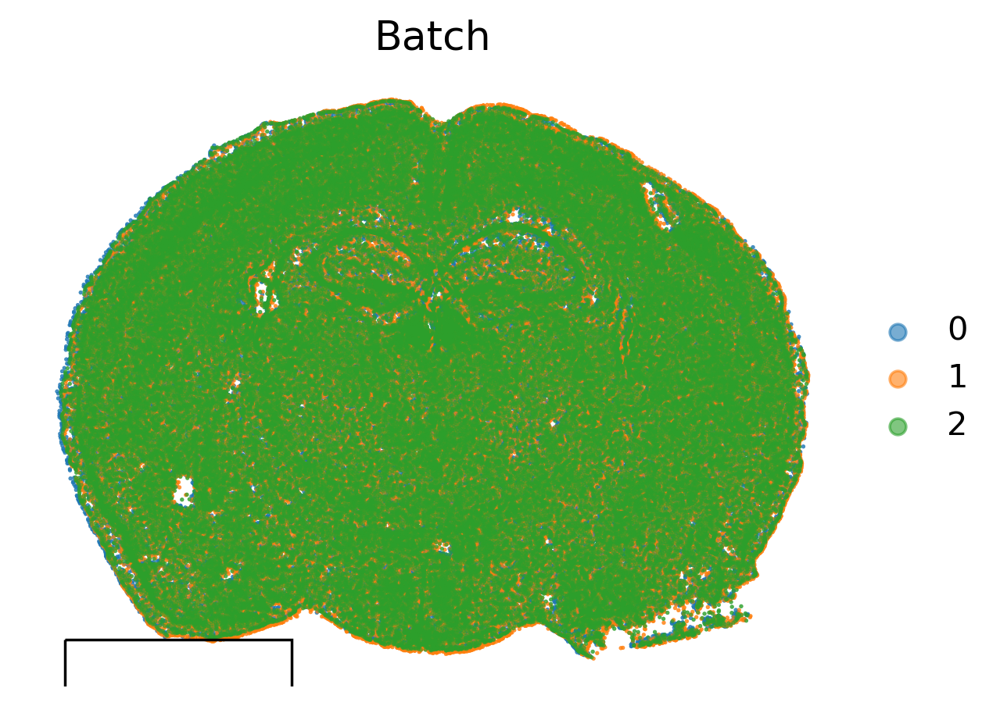

In [118]:
ax = sq.pl.spatial_scatter(
    adata,
    spatial_key="spatial_rot",
    shape=None,
    color=["batch_final"],
    size=1,
    figsize=(5, 5),
    # legend_loc=None,
    edgecolors=None,
    frameon=False,
    alpha=0.6,
    dpi=250,
    return_ax=True,
    title="Batch",
)

rect = mpl.patches.Rectangle(
    (-inset_ymin, inset_xmin),
    width=inset_xmax - inset_xmin,
    height=inset_ymax - inset_ymin,
    ec="black",
    lw=1,
    fill=False,
)
ax.add_patch(rect)

## Old

In [5]:
arr = adata.obsm["spatial_norm_final"].copy()
xv = np.linspace(arr[:, 0].min(), arr[:, 0].max(), 200)
yv = np.linspace(arr[:, 1].min(), arr[:, 1].max(), 200)

In [6]:
adata.X = adata.X.A.copy()

In [7]:
from itertools import tee, product


def pairwise(iterable):
    # pairwise('ABCDEFG') --> AB BC CD DE EF FG
    a, b = tee(iterable)
    next(b, None)
    return zip(a, b)


def aggregate(x_vals, y_vals, arr, adata):
    x_min, x_max = x_vals
    y_min, y_max = y_vals
    cond = (
        (x_min < arr[:, 0])
        & (arr[:, 0] <= x_max)
        & (y_min < arr[:, 1])
        & (arr[:, 1] <= y_max)
    )
    x_mean = np.mean([x_min, x_max])
    y_mean = np.mean([y_min, y_max])
    if sum(cond):
        sum_coords = sum(cond)
        coords = np.array([x_mean, y_mean])
        means = np.array(adata[cond].X).mean(0)
        var = np.array(adata[cond].X).var(0)
        medians = np.median(np.array(adata[cond].X), 0)
        batches = adata[cond].obs.batch_final.values
        out = {
            "sum_points": sum_coords,
            "coords": coords,
            "means": means,
            "var": var,
            "medians": medians,
            "batches": batches,
        }
        return out

In [8]:
res = Parallel(n_jobs=20)(
    delayed(aggregate)(x_val, y_val, arr, adata)
    for x_val, y_val in product(pairwise(xv), pairwise(yv))
)

In [9]:
spatial = np.vstack([i["coords"] for i in res if i is not None])
means = np.vstack([i["means"] for i in res if i is not None])
medians = np.vstack([i["medians"] for i in res if i is not None])
var = np.vstack([i["var"] for i in res if i is not None])
cv = np.sqrt(var) / means

/tmp/ipykernel_1576898/2124460658.py:5: RuntimeWarning: invalid value encountered in divide
  cv = np.sqrt(var) / means


In [10]:
batch_count = [i["batches"] for i in res if i is not None]
batch_sum = [len(i.categories) for i in batch_count]

In [11]:
adata_grid = AnnData(means, obsm={"spatial": spatial})
adata_grid.var_names = adata.var_names
adata_grid.obs["sum_cells"] = np.array([i["sum_points"] for i in res if i is not None])
adata_grid.obs["sum_batch"] = batch_sum
adata_grid.obs["batches"] = batch_count

In [12]:
adata_grid.layers["X_var"] = var
adata_grid.layers["X_median"] = medians
adata_grid.layers["X_cv"] = medians

<Axes: xlabel='sum_cells', ylabel='Count'>

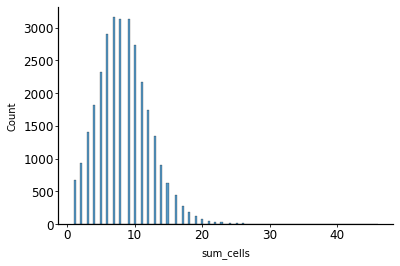

In [13]:
sns.histplot(adata_grid.obs["sum_cells"])

<Axes: xlabel='sum_batch', ylabel='Count'>

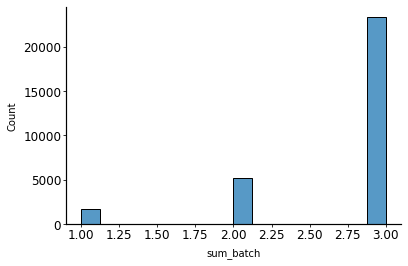

In [14]:
sns.histplot(adata_grid.obs["sum_batch"])

In [15]:
cond = (adata_grid.obs["sum_batch"] > 2) & (adata_grid.obs["sum_cells"] > 2)
adata_final = adata_grid[cond].copy()
adata_final

AnnData object with n_obs × n_vars = 23343 × 483
    obs: 'sum_cells', 'sum_batch', 'batches'
    obsm: 'spatial'
    layers: 'X_var', 'X_median', 'X_cv'

In [16]:
batch_list = adata_final.obs["batches"].map(lambda x: x.value_counts().values / len(x))
batch_df = pd.DataFrame.from_dict(dict(zip(batch_list.index, batch_list.values))).T
adata_final.obs.drop(columns="batches", inplace=True)
batch_df

,0,1,2
100,0.333333,0.500000,0.166667
101,0.200000,0.600000,0.200000
104,0.375000,0.250000,0.375000
105,0.200000,0.200000,0.600000
107,0.333333,0.500000,0.166667
...,...,...,...
30317,0.125000,0.375000,0.500000
30318,0.400000,0.400000,0.200000
30319,0.500000,0.333333,0.166667
30320,0.142857,0.285714,0.571429


In [17]:
for c in batch_df.columns:
    adata_final.obs[f"batch_{c}"] = batch_df[c].values

In [18]:
from scipy.stats import entropy

adata_final.obs["batch_entropy"] = adata_final.obs[
    [f"batch_{c}" for c in [0, 1, 2]]
].apply(entropy, axis=1)
adata_final.obs

,sum_cells,sum_batch,batch_0,batch_1,batch_2,batch_entropy
100,6,3,0.333333,0.500000,0.166667,1.011404
101,5,3,0.200000,0.600000,0.200000,0.950271
104,8,3,0.375000,0.250000,0.375000,1.082196
105,5,3,0.200000,0.200000,0.600000,0.950271
107,6,3,0.333333,0.500000,0.166667,1.011404
...,...,...,...,...,...,...
30317,8,3,0.125000,0.375000,0.500000,0.974315
30318,5,3,0.400000,0.400000,0.200000,1.054920
30319,6,3,0.500000,0.333333,0.166667,1.011404
30320,7,3,0.142857,0.285714,0.571429,0.955700


In [19]:
rot = rotation_matrix(13)
adata_final.obsm["spatial_rot"] = adata_final.obsm["spatial"] @ rot

In [20]:
# adata_final = sc.read(root / "adata_full_FGW_RUN_ALIGNED_MINMAX_FINAL.h5ad")

In [21]:
from scipy.stats import spearmanr

d = {}
for g in adata_final.var_names:
    d[g], _ = spearmanr(
        adata_final[:, g].X.flatten(),
        adata_final[:, g].layers["X_var"].flatten(),
    )

In [22]:
pd.Series(d).dropna().sort_values(ascending=False)

Mrgprg     0.999999
Vmn1r53    0.999999
Gpr18      0.999999
Cxcr6      0.999998
Ccr8       0.999998
             ...   
Adgrb1    -0.134781
Celsr2    -0.176686
Cspg5     -0.282629
Adgrl1    -0.282759
Gabbr1    -0.439372
Length: 483, dtype: float64

In [23]:
# pd.Series(
#     {k: v for k, v in zip(adata_final.var_names, adata_final.layers["X_cv"].mean(0))}
# ).sort_values()

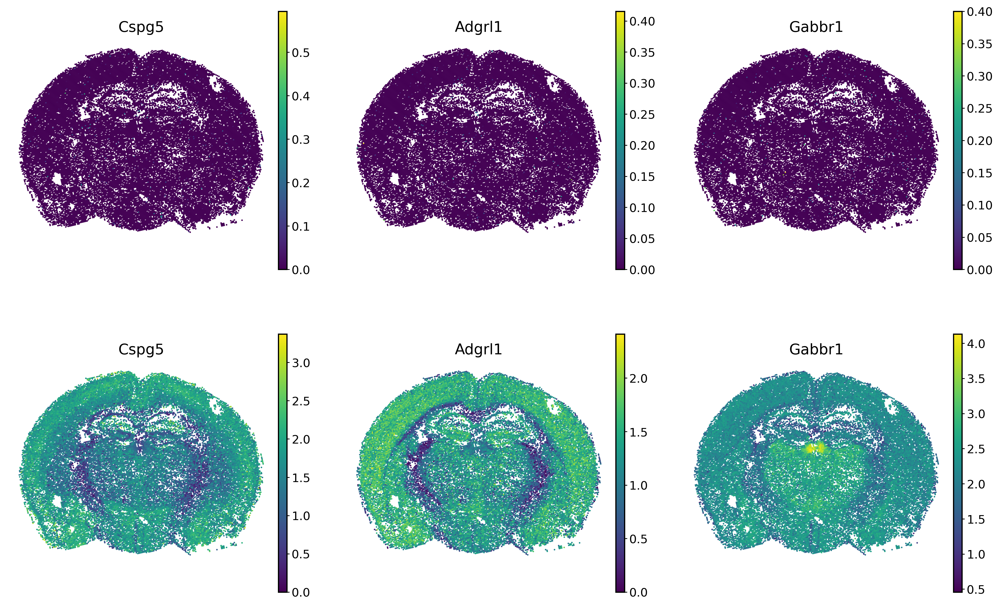

In [28]:
genes_high = ["Cxcr6", "Ccr8", "Gpr18"]
genes_low = ["Cspg5", "Adgrl1", "Gabbr1"]
sq.pl.spatial_scatter(
    adata_final,
    spatial_key="spatial_rot",
    shape=None,
    # layer="X_cv",
    color=genes_high + genes_low,
    size=1,
    frameon=False,
    figsize=(5, 5),
    title=genes_low + genes_low,
    ncols=3,
    dpi=300,
)

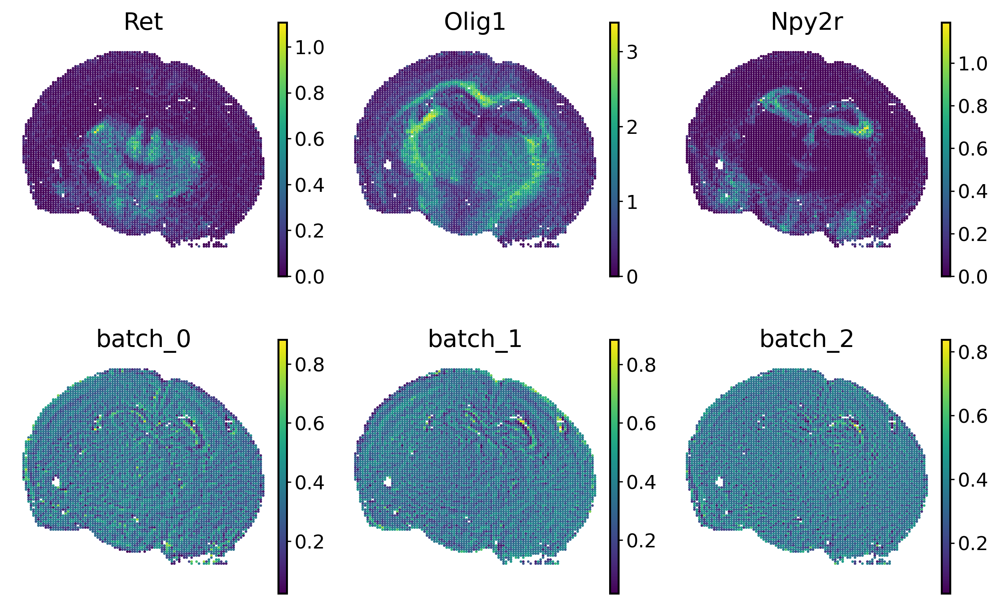

In [26]:
genes = ["Ret", "Olig1", "Npy2r"]
batches = ["batch_0", "batch_1", "batch_2"]
sq.pl.spatial_scatter(
    adata_final,
    shape=None,
    color=genes + batches,
    size=1,
    frameon=False,
    figsize=(3, 3),
    title=genes + batches,
    ncols=3,
    dpi=300,
)

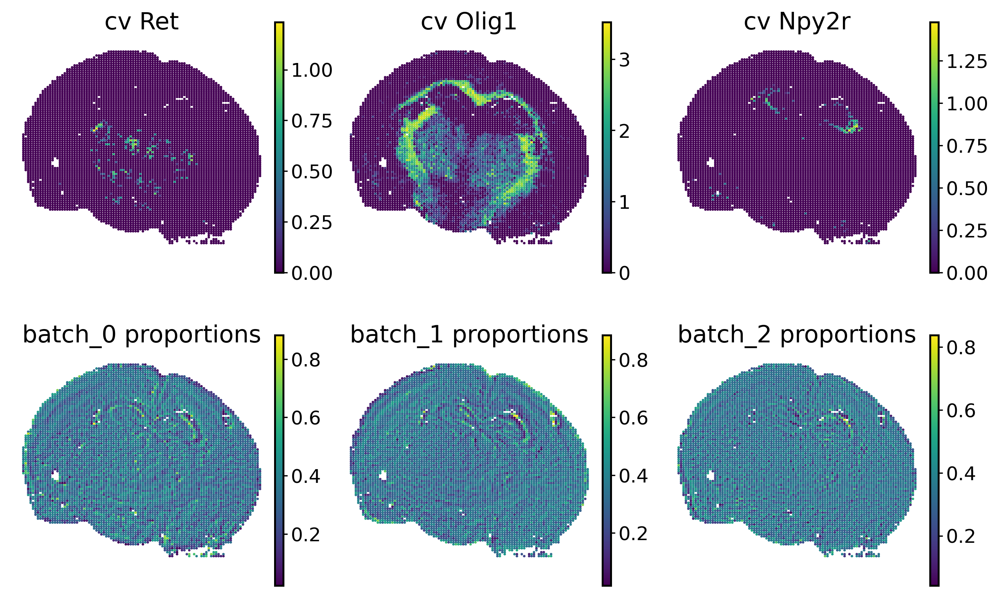

In [27]:
genes = ["Ret", "Olig1", "Npy2r"]
batches = ["batch_0", "batch_1", "batch_2"]
sq.pl.spatial_scatter(
    adata_final,
    shape=None,
    color=genes + batches,
    size=1,
    layer="X_cv",
    frameon=False,
    figsize=(3, 3),
    title=[f"cv {g}" for g in genes] + [f"{b} proportions" for b in batches],
    ncols=3,
    dpi=300,
)

In [28]:
adata_final

AnnData object with n_obs × n_vars = 7196 × 483
    obs: 'sum_cells', 'sum_batch', 'batch_0', 'batch_1', 'batch_2', 'batch_entropy'
    obsm: 'spatial'
    layers: 'X_var', 'X_median', 'X_cv'

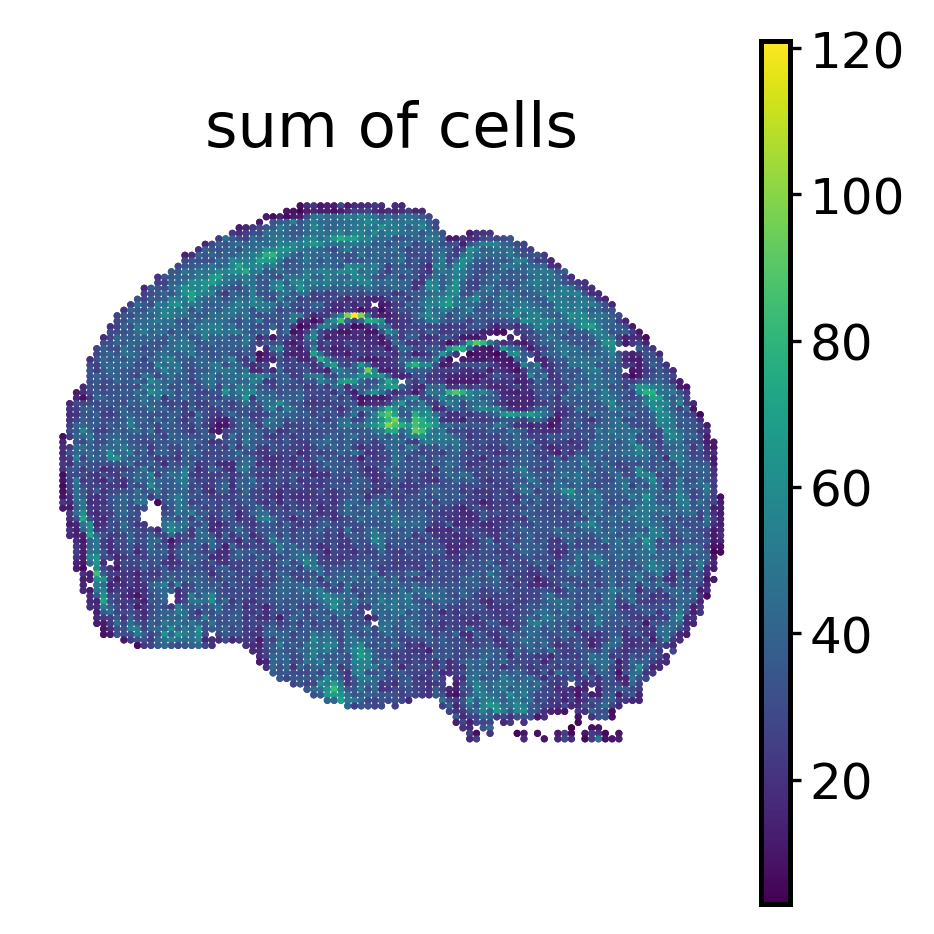

In [30]:
sq.pl.spatial_scatter(
    adata_final,
    shape=None,
    color=["sum_cells"],
    size=2,
    frameon=False,
    figsize=(3, 3),
    title="sum of cells",
    dpi=300,
)